# Import libraries

In [1]:
import pandas as pd
import numpy as np
import uuid
import random
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
import sklearn
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
import statsmodels.api as sm
from sklearn.base import TransformerMixin
from scipy import stats
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
sns.set_style("ticks")

# Importing the Data


In [2]:
houses= pd.read_csv('train.csv')

In [3]:
houses.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [4]:
houses.shape

(1460, 81)

In [5]:
houses.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
                  ...   
MoSold             int64
YrSold             int64
SaleType          object
SaleCondition     object
SalePrice          int64
Length: 81, dtype: object

In [6]:
houses.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64

Now are going to separate the variables into numerical and categorical to facilitate the analysis. We're going to select from each group the most significant to proceed with more in-deep analysis and contruct a predictive model.

# Numerical Variables

In [7]:
#houses._get_numeric_data().columns
numerical_houses = houses[list(houses._get_numeric_data().columns)].reset_index(drop=True)
numerical_houses

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,1,60,65.0,8450,7,5,2003,2003,196.0,706,...,0,61,0,0,0,0,0,2,2008,208500
1,2,20,80.0,9600,6,8,1976,1976,0.0,978,...,298,0,0,0,0,0,0,5,2007,181500
2,3,60,68.0,11250,7,5,2001,2002,162.0,486,...,0,42,0,0,0,0,0,9,2008,223500
3,4,70,60.0,9550,7,5,1915,1970,0.0,216,...,0,35,272,0,0,0,0,2,2006,140000
4,5,60,84.0,14260,8,5,2000,2000,350.0,655,...,192,84,0,0,0,0,0,12,2008,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,62.0,7917,6,5,1999,2000,0.0,0,...,0,40,0,0,0,0,0,8,2007,175000
1456,1457,20,85.0,13175,6,6,1978,1988,119.0,790,...,349,0,0,0,0,0,0,2,2010,210000
1457,1458,70,66.0,9042,7,9,1941,2006,0.0,275,...,0,60,0,0,0,0,2500,5,2010,266500
1458,1459,20,68.0,9717,5,6,1950,1996,0.0,49,...,366,0,112,0,0,0,0,4,2010,142125


Now we extract a summary from the numerical values. 

In [8]:
def extractSummmary(df):
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values    
    summary['Missing %'] = (df.isnull().sum()/df.isnull().count()*100).values
    summary['Uniques'] = df.nunique().values
    summary['Uniques %'] = (df.nunique().values/df.count()*100).values
    summary['Median'] = df.median().values
    summary['Mean'] = df.mean().values
    summary['Max'] = df.max().values
    summary['Min'] = df.min().values    
    summary['std'] = df.std().values
    return summary

In [9]:
extractSummmary(numerical_houses)

,Name,dtypes,Missing,Missing %,Uniques,Uniques %,Median,Mean,Max,Min,std
0,Id,int64,0,0.000000,1460,100.000000,730.5,730.500000,1460.0,1.0,421.610009
1,MSSubClass,int64,0,0.000000,15,1.027397,50.0,56.897260,190.0,20.0,42.300571
2,LotFrontage,float64,259,17.739726,110,9.159034,69.0,70.049958,313.0,21.0,24.284752
3,LotArea,int64,0,0.000000,1073,73.493151,9478.5,10516.828082,215245.0,1300.0,9981.264932
4,OverallQual,int64,0,0.000000,10,0.684932,6.0,6.099315,10.0,1.0,1.382997
5,OverallCond,int64,0,0.000000,9,0.616438,5.0,5.575342,9.0,1.0,1.112799
6,YearBuilt,int64,0,0.000000,112,7.671233,1973.0,1971.267808,2010.0,1872.0,30.202904
7,YearRemodAdd,int64,0,0.000000,61,4.178082,1994.0,1984.865753,2010.0,1950.0,20.645407
8,MasVnrArea,float64,8,0.547945,327,22.520661,0.0,103.685262,1600.0,0.0,181.066207
9,BsmtFinSF1,int64,0,0.000000,637,43.630137,383.5,443.639726,5644.0,0.0,456.098091


Based on our summary, there are not enough null values to drop none of the numerical values. Now we're going to get some visual insighs from the numerical values. 

In [10]:
target_feature = 'SalePrice'

def plot_boxplot(df, column, target_feature):
    sns.boxplot(x=column, y=target_feature, data = df)

def plot_dist(df,columns,f):
    ax1 = f.add_subplot(121)
    
    sns.distplot(df[columns],kde_kws={'bw': 0.1})
    ax2 = f.add_subplot(122)
    stats.probplot(df[columns], plot=ax2)

def plot_bar(df,column):
    sns.barplot(column,'SalePrice',data = df, alpha=0.9)
#    sns.barplot(df.index, df.values, alpha=0.9)

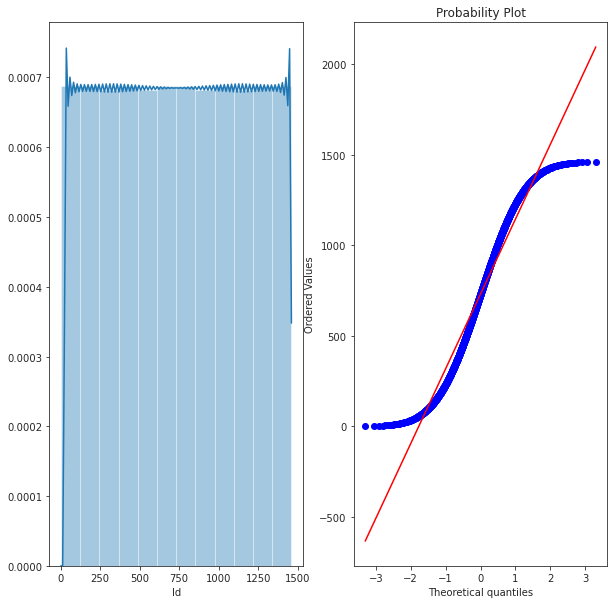

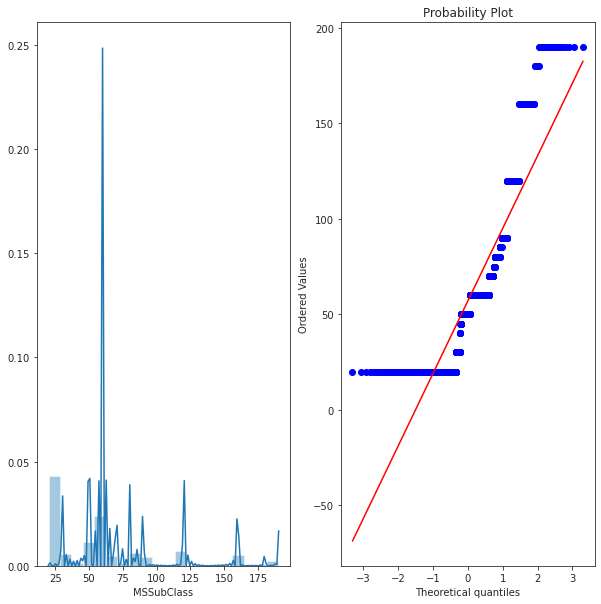

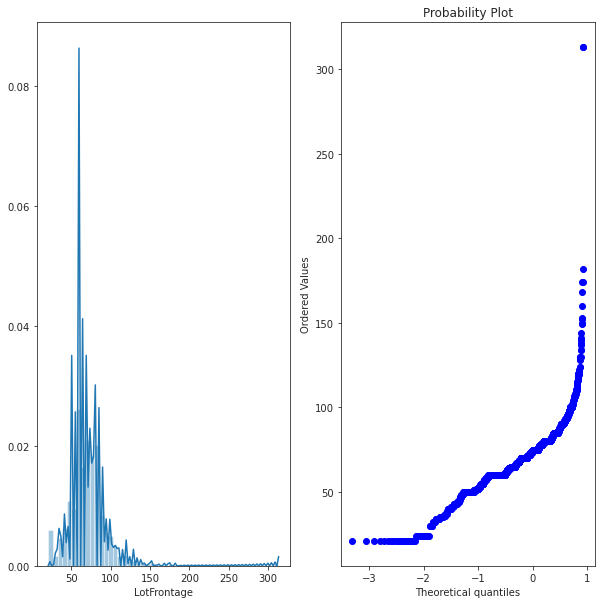

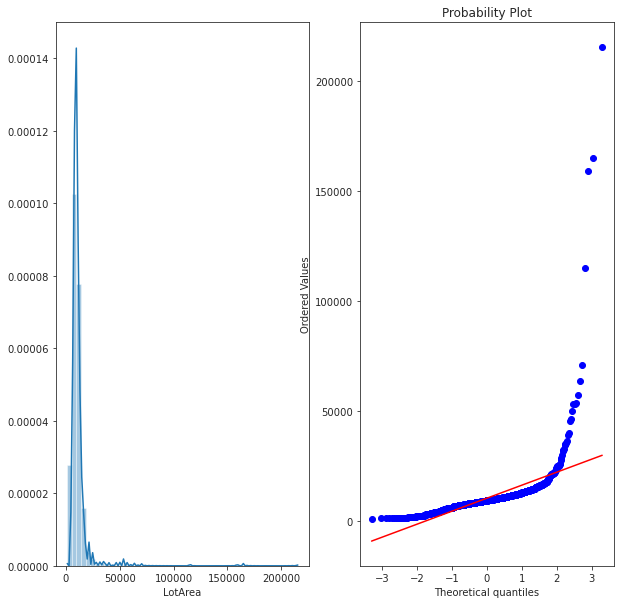

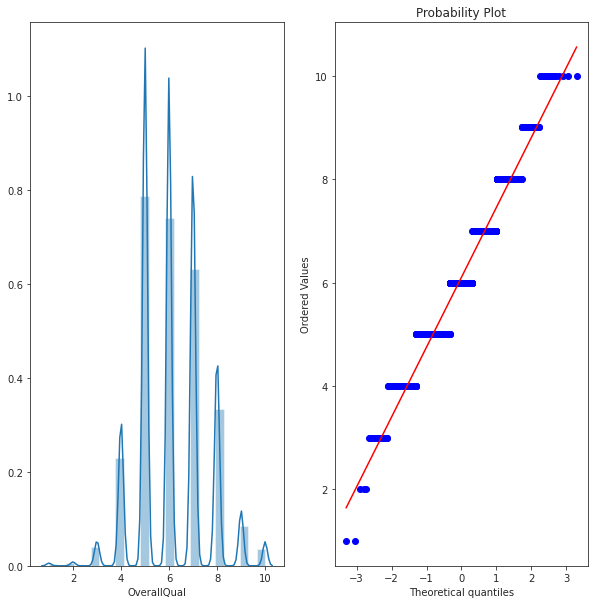

...

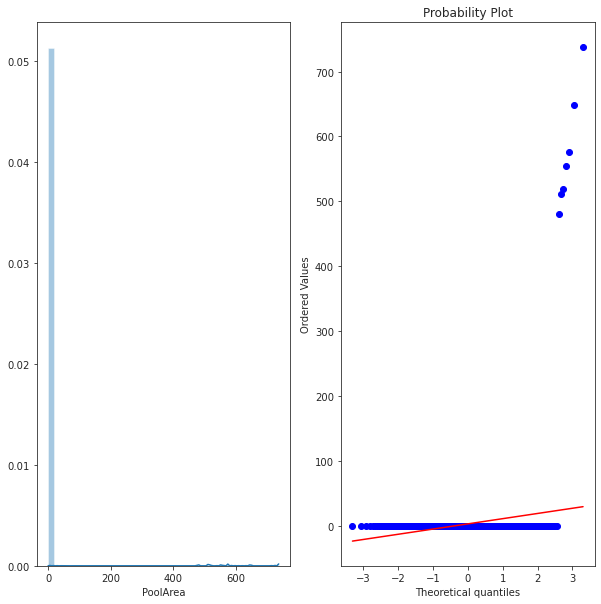

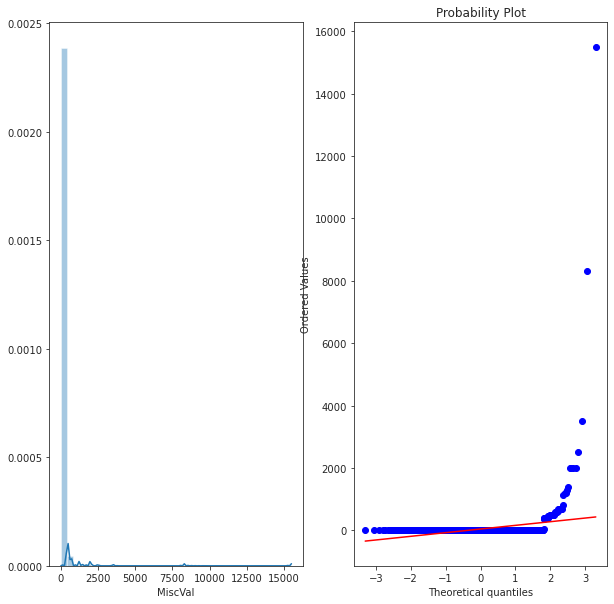

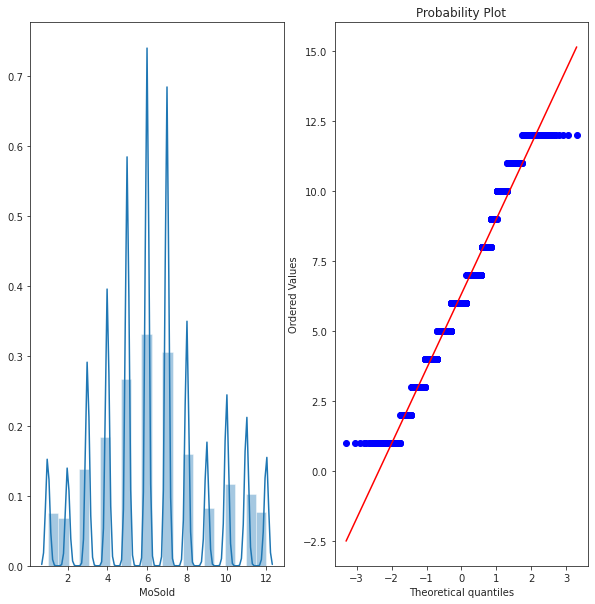

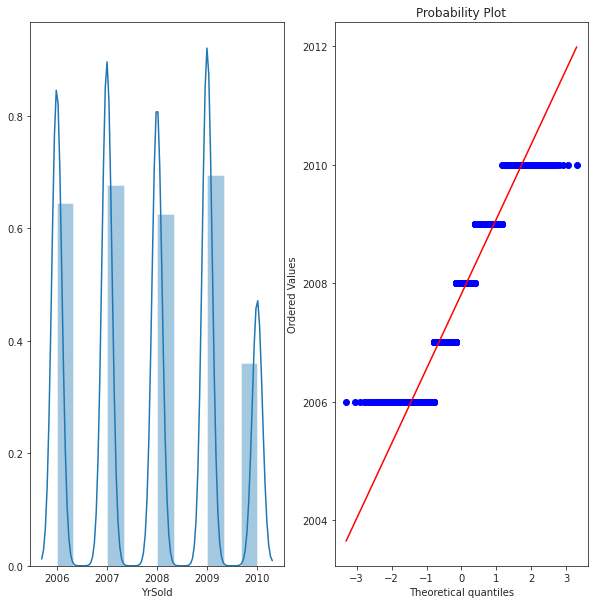

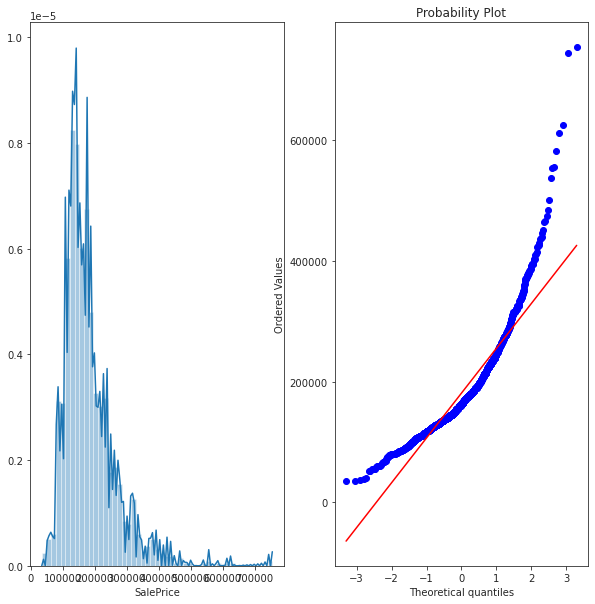

In [11]:
#sns.pairplotrplot(numerical_houses)
for i,column in enumerate(numerical_houses.columns):
    f = plt.figure(figsize=(10,10))
    plot_dist(numerical_houses, column, f)

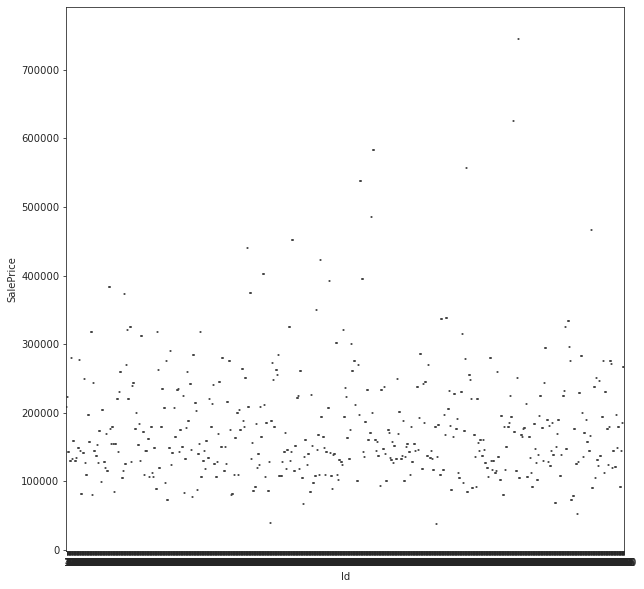

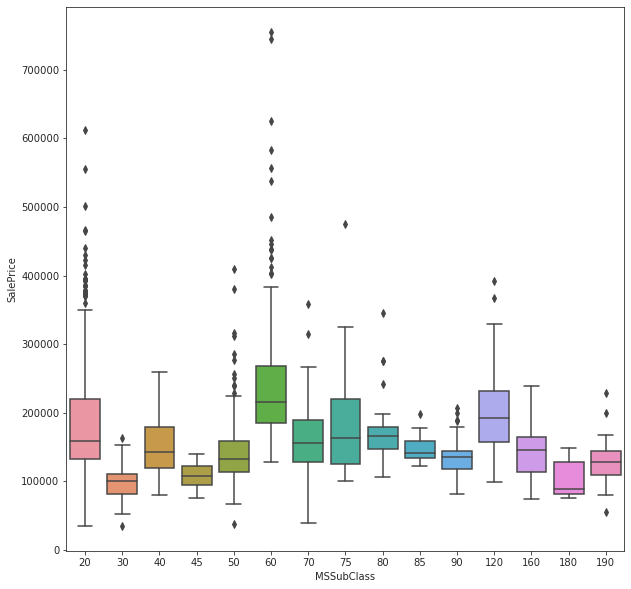

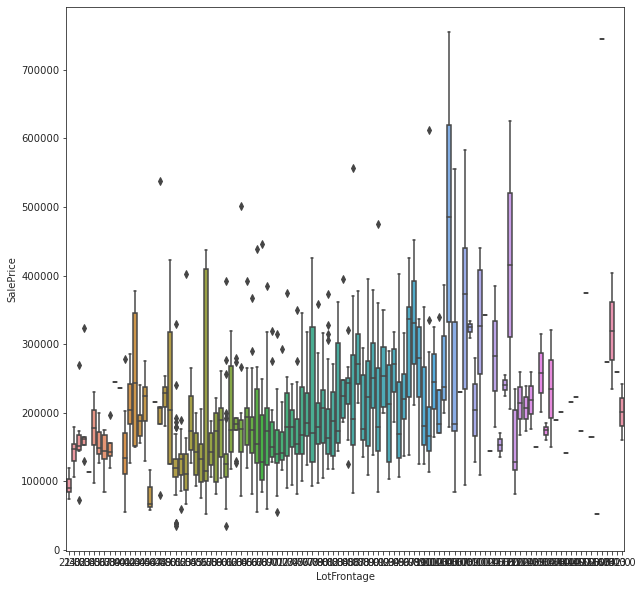

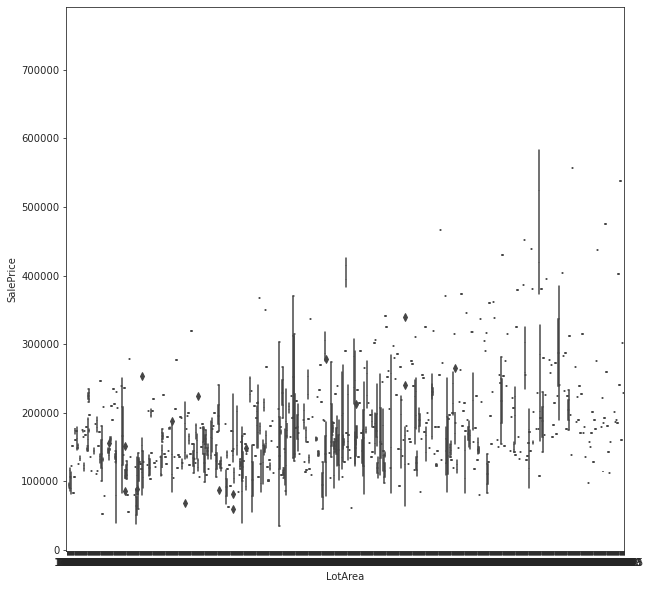

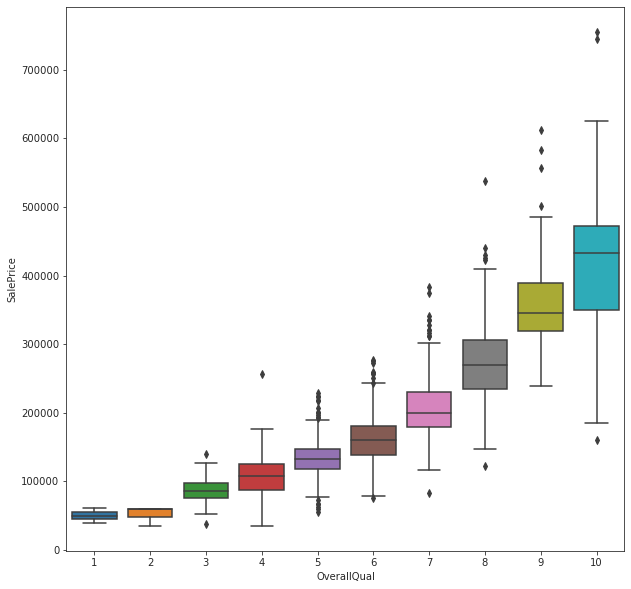

...

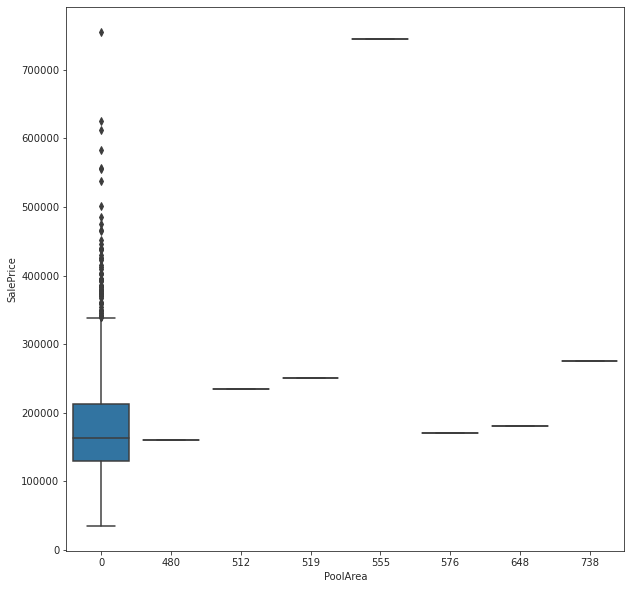

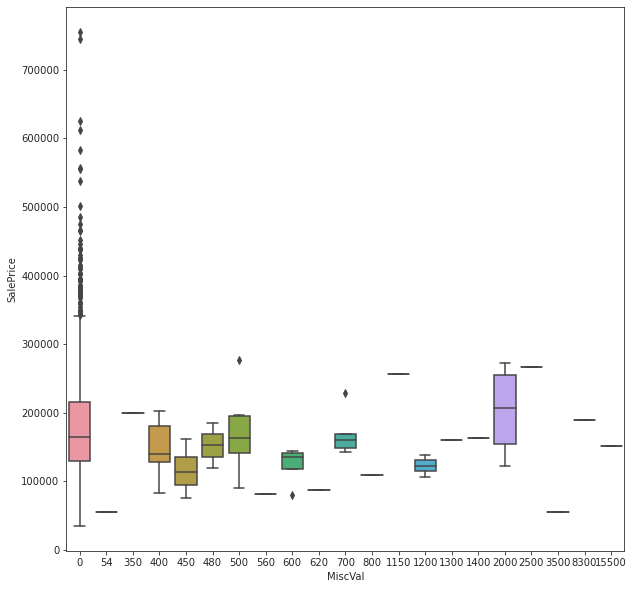

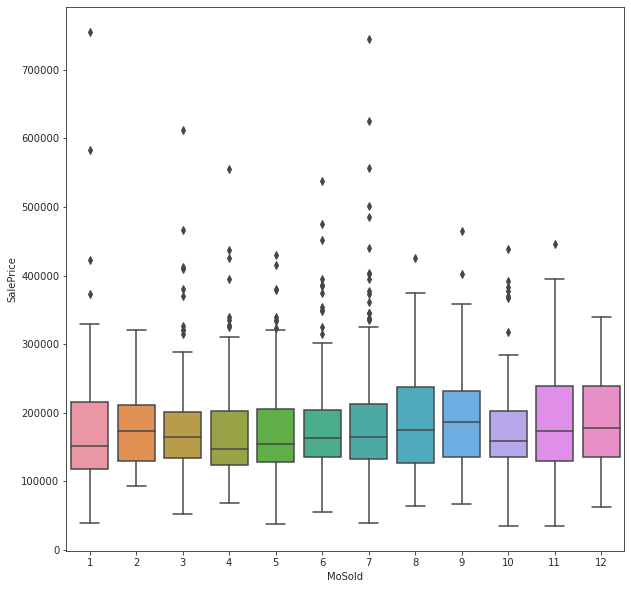

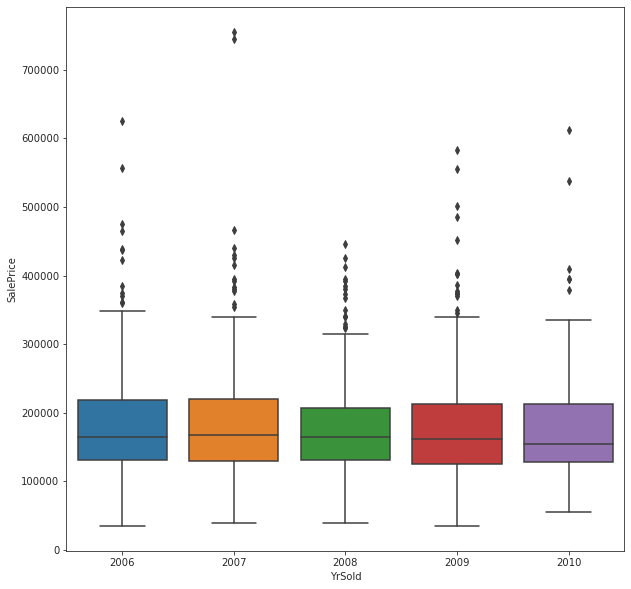

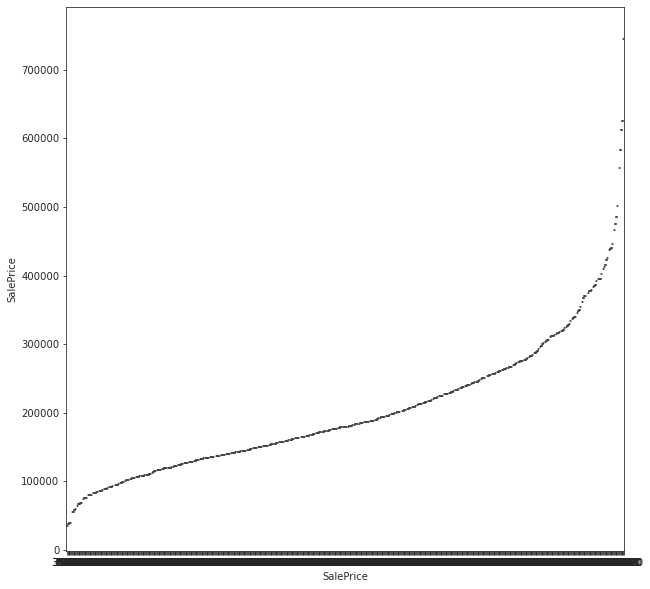

In [12]:
for i,column in enumerate(numerical_houses.columns):
    f = plt.figure(figsize=(10,10))
    plot_boxplot(numerical_houses, column, target_feature)

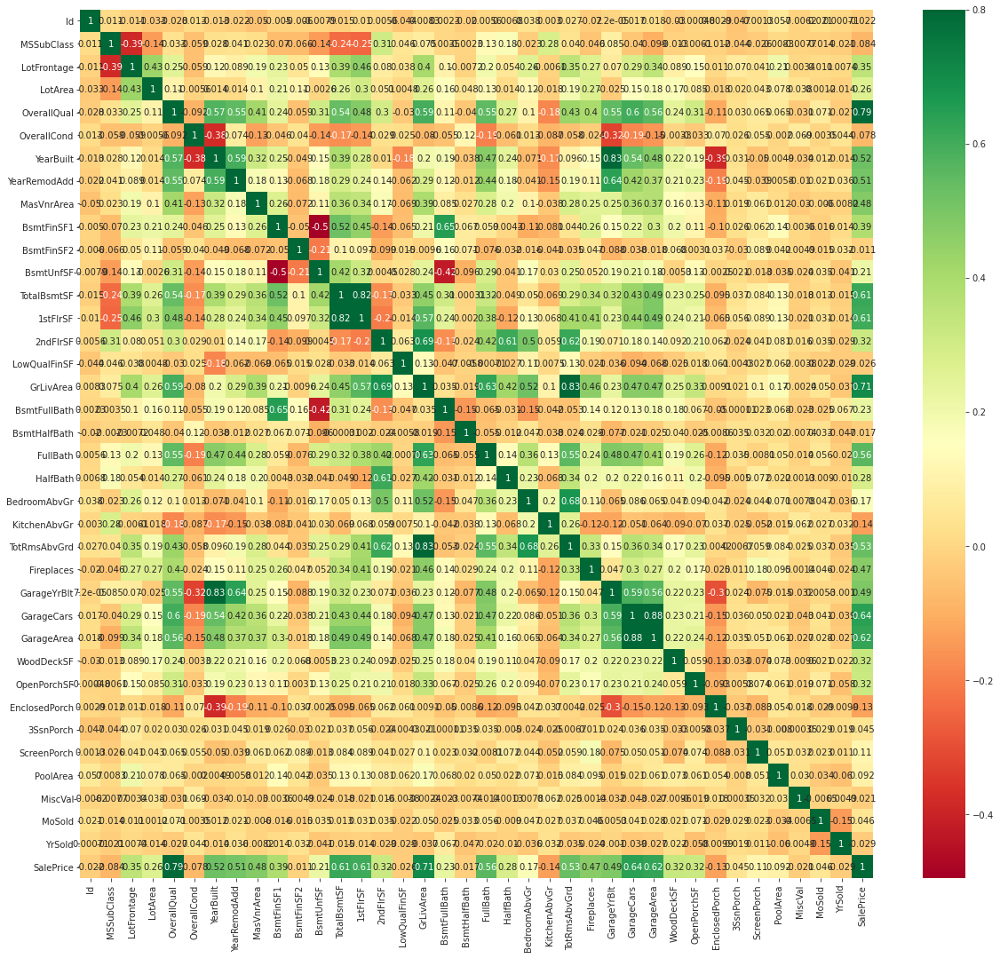

In [13]:
#correlation matrix
f, ax = plt.subplots(figsize=(20, 18))
sns.heatmap( numerical_houses.corr(), vmax=.8, annot=True,cmap='RdYlGn',annot_kws={'size':10});


### Based on the correlation matrix we're going to proceed with whe columns with correlation above 50%

In [14]:
good_num=numerical_houses.corr()["SalePrice"][abs(numerical_houses.corr()["SalePrice"])>0.5]
good_num

OverallQual     0.790982
YearBuilt       0.522897
YearRemodAdd    0.507101
TotalBsmtSF     0.613581
1stFlrSF        0.605852
GrLivArea       0.708624
FullBath        0.560664
TotRmsAbvGrd    0.533723
GarageCars      0.640409
GarageArea      0.623431
SalePrice       1.000000
Name: SalePrice, dtype: float64

In [15]:
numerical_clean=numerical_houses[list(good_num.index)]

In [16]:
numerical_clean

,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,GarageArea,SalePrice
0,7,2003,2003,856,856,1710,2,8,2,548,208500
1,6,1976,1976,1262,1262,1262,2,6,2,460,181500
2,7,2001,2002,920,920,1786,2,6,2,608,223500
3,7,1915,1970,756,961,1717,1,7,3,642,140000
4,8,2000,2000,1145,1145,2198,2,9,3,836,250000
...,...,...,...,...,...,...,...,...,...,...,...
1455,6,1999,2000,953,953,1647,2,7,2,460,175000
1456,6,1978,1988,1542,2073,2073,2,7,2,500,210000
1457,7,1941,2006,1152,1188,2340,2,9,1,252,266500
1458,5,1950,1996,1078,1078,1078,1,5,1,240,142125


In [17]:
numerical_clean.drop(['SalePrice'],
              axis=1, inplace=True)

# Categorical variables
Same process as with the numerical variables

In [18]:
categorical_houses = houses[list(set(houses.columns) - set(houses._get_numeric_data().columns))].reset_index(drop=True)
categorical_houses

,MasVnrType,BsmtCond,Functional,FireplaceQu,BsmtFinType1,ExterQual,MiscFeature,LandSlope,Electrical,Heating,...,BldgType,BsmtExposure,Utilities,Street,RoofStyle,HeatingQC,PavedDrive,MSZoning,KitchenQual,BsmtFinType2
0,BrkFace,TA,Typ,NaN,GLQ,Gd,NaN,Gtl,SBrkr,GasA,...,1Fam,No,AllPub,Pave,Gable,Ex,Y,RL,Gd,Unf
1,None,TA,Typ,TA,ALQ,TA,NaN,Gtl,SBrkr,GasA,...,1Fam,Gd,AllPub,Pave,Gable,Ex,Y,RL,TA,Unf
2,BrkFace,TA,Typ,TA,GLQ,Gd,NaN,Gtl,SBrkr,GasA,...,1Fam,Mn,AllPub,Pave,Gable,Ex,Y,RL,Gd,Unf
3,None,Gd,Typ,Gd,ALQ,TA,NaN,Gtl,SBrkr,GasA,...,1Fam,No,AllPub,Pave,Gable,Gd,Y,RL,Gd,Unf
4,BrkFace,TA,Typ,TA,GLQ,Gd,NaN,Gtl,SBrkr,GasA,...,1Fam,Av,AllPub,Pave,Gable,Ex,Y,RL,Gd,Unf
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,None,TA,Typ,TA,Unf,TA,NaN,Gtl,SBrkr,GasA,...,1Fam,No,AllPub,Pave,Gable,Ex,Y,RL,TA,Unf
1456,Stone,TA,Min1,TA,ALQ,TA,NaN,Gtl,SBrkr,GasA,...,1Fam,No,AllPub,Pave,Gable,TA,Y,RL,TA,Rec
1457,None,Gd,Typ,Gd,GLQ,Ex,Shed,Gtl,SBrkr,GasA,...,1Fam,No,AllPub,Pave,Gable,Ex,Y,RL,Gd,Unf
1458,None,TA,Typ,NaN,GLQ,TA,NaN,Gtl,FuseA,GasA,...,1Fam,Mn,AllPub,Pave,Hip,Gd,Y,RL,Gd,Rec


In [19]:
def extractSummmaryCategory(df):
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values
    summary['Missing %'] = (df.isnull().sum()/df.isnull().count()*100).values

    summary['Uniques'] = df.nunique().values
    return summary

In [20]:
extractSummmaryCategory(categorical_houses)

,Name,dtypes,Missing,Missing %,Uniques
0,MasVnrType,object,8,0.547945,4
1,BsmtCond,object,37,2.534247,4
2,Functional,object,0,0.000000,7
3,FireplaceQu,object,690,47.260274,5
4,BsmtFinType1,object,37,2.534247,6
5,ExterQual,object,0,0.000000,4
6,MiscFeature,object,1406,96.301370,4
7,LandSlope,object,0,0.000000,3
8,Electrical,object,1,0.068493,5
9,Heating,object,0,0.000000,6


In [21]:
columns=list(houses.columns)
print(columns)

['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'PoolQC'

#### This function counst all the null values in each column and return only the columns with certain number of null values

In [22]:
def null_counts_col(df,num):
    columns=list(df.columns)
    for column in columns:
        null_values=df[column].isnull().sum()
        if null_values >= num:
            print (f"The column {column} has {null_values} null/na values.")       

In [23]:
null_counts_col(numerical_houses,10)

The column LotFrontage has 259 null/na values.
The column GarageYrBlt has 81 null/na values.


There are not enough null values in this columns to delete them.

In [24]:
null_counts_col(categorical_houses,10)

The column BsmtCond has 37 null/na values.
The column FireplaceQu has 690 null/na values.
The column BsmtFinType1 has 37 null/na values.
The column MiscFeature has 1406 null/na values.
The column GarageType has 81 null/na values.
The column Fence has 1179 null/na values.
The column Alley has 1369 null/na values.
The column GarageFinish has 81 null/na values.
The column BsmtQual has 37 null/na values.
The column GarageCond has 81 null/na values.
The column GarageQual has 81 null/na values.
The column PoolQC has 1453 null/na values.
The column BsmtExposure has 38 null/na values.
The column BsmtFinType2 has 38 null/na values.


#### This function return the rows with more than certain number  of null values

In [25]:
#this function returns the rows with more than n missing values
def null_counts_row(df,num):
    return df.loc[df.isnull().sum(axis = 1)>=num]

In [26]:
null_counts_row(numerical_houses,8)

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice


In [27]:
null_counts_row(categorical_houses,10)

,MasVnrType,BsmtCond,Functional,FireplaceQu,BsmtFinType1,ExterQual,MiscFeature,LandSlope,Electrical,Heating,...,BldgType,BsmtExposure,Utilities,Street,RoofStyle,HeatingQC,PavedDrive,MSZoning,KitchenQual,BsmtFinType2
39,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseP,GasA,...,Duplex,NaN,AllPub,Pave,Gable,TA,N,RL,Fa,NaN
90,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseA,GasA,...,1Fam,NaN,AllPub,Pave,Gable,TA,Y,RL,TA,NaN
102,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,SBrkr,GasA,...,Duplex,NaN,AllPub,Pave,Gable,TA,Y,RL,TA,NaN
156,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseF,GasA,...,1Fam,NaN,AllPub,Pave,Hip,TA,Y,RL,TA,NaN
259,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseA,GasA,...,1Fam,NaN,AllPub,Pave,Gable,Gd,Y,RM,TA,NaN
342,BrkFace,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseA,Wall,...,Duplex,NaN,AllPub,Pave,Gable,Fa,Y,RL,TA,NaN
520,None,NaN,Typ,NaN,NaN,TA,NaN,Gtl,FuseA,GasA,...,2fmCon,NaN,AllPub,Pave,Gable,TA,N,RL,TA,NaN
533,None,NaN,Typ,NaN,NaN,Fa,NaN,Mod,FuseF,GasA,...,1Fam,NaN,AllPub,Pave,Gable,Fa,N,RL,Fa,NaN
646,None,NaN,Min1,NaN,NaN,TA,NaN,Gtl,SBrkr,GasA,...,1Fam,NaN,AllPub,Pave,Hip,Gd,Y,RL,TA,NaN
705,None,NaN,Mod,NaN,NaN,Fa,Othr,Gtl,SBrkr,GasA,...,2fmCon,NaN,AllPub,Pave,Hip,Fa,N,RM,Fa,NaN


Before removing any record based on null values fisrt we need to remove the columns with that are not usefull for analysis.

## Removing unnecesary columns


In [28]:
houses.drop(['Alley','PoolQC','Fence','MiscFeature','FireplaceQu'],
              axis=1, inplace=True)

# Getting dummy variables from the categorical variables.

In [29]:
dummies_categorical=pd.get_dummies(categorical_houses, dummy_na=False).copy()

In [30]:
dummies_categorical['SalePrice']=numerical_houses['SalePrice'].copy()

In [31]:
dummies_categorical

,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,Functional_Maj1,Functional_Maj2,...,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,SalePrice
0,0,1,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,1,208500
1,0,0,1,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,1,181500
2,0,1,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,1,223500
3,0,0,1,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,1,140000
4,0,1,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,1,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,0,0,1,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,1,175000
1456,0,0,0,1,0,0,0,1,0,0,...,0,0,1,0,0,0,0,1,0,210000
1457,0,0,1,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,1,266500
1458,0,0,1,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,1,0,142125


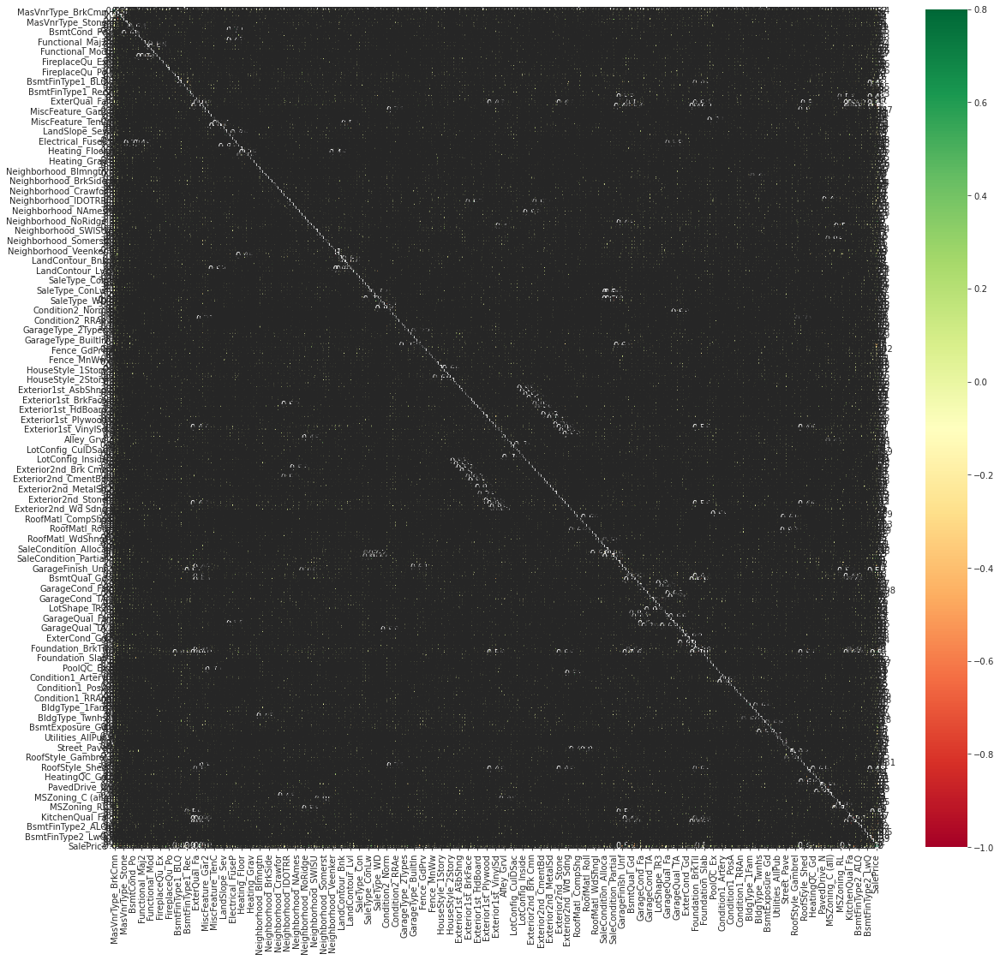

In [32]:
f, ax = plt.subplots(figsize=(20, 18))
sns.heatmap( dummies_categorical.corr(), vmax=.8, annot=True,cmap='RdYlGn',annot_kws={'size':10});


As we can see, is not possible get any meaningful  information from this correlation matrix, is necessary filter this first. 

In [33]:
dummies_categorical.corr().style.background_gradient(cmap='Blues')

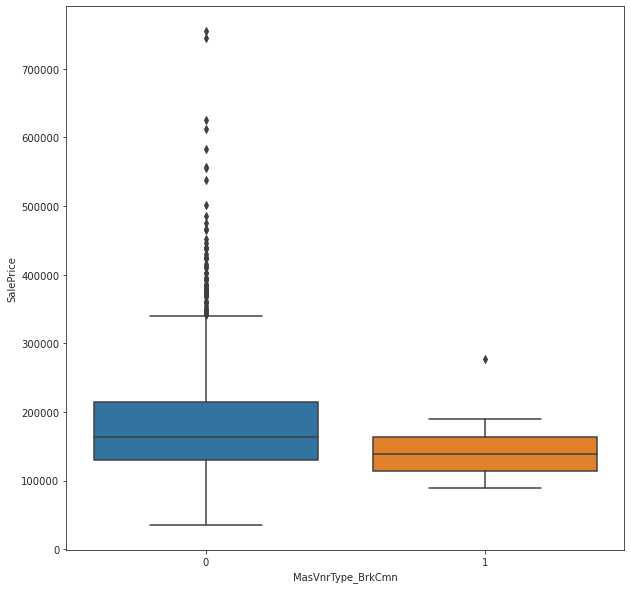

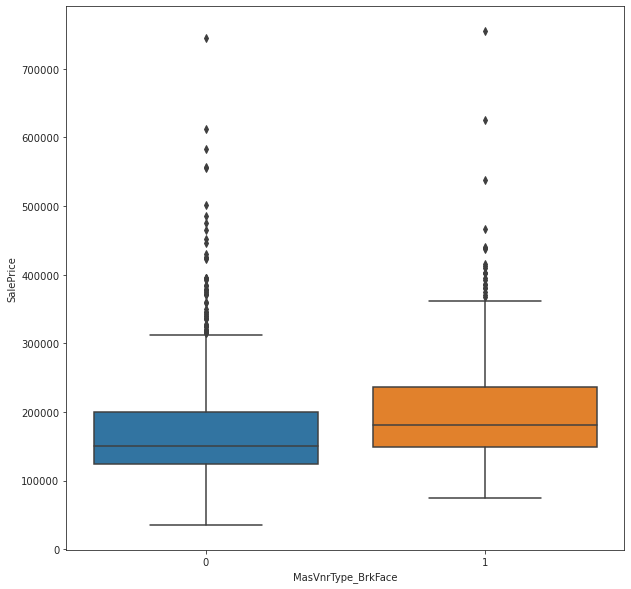

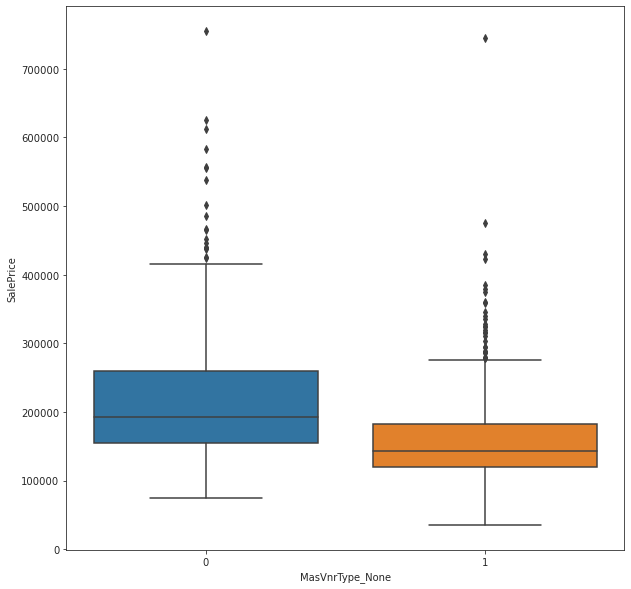

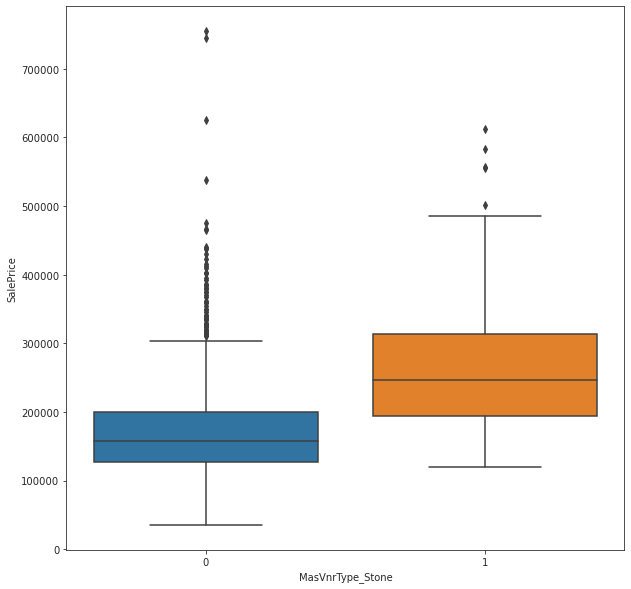

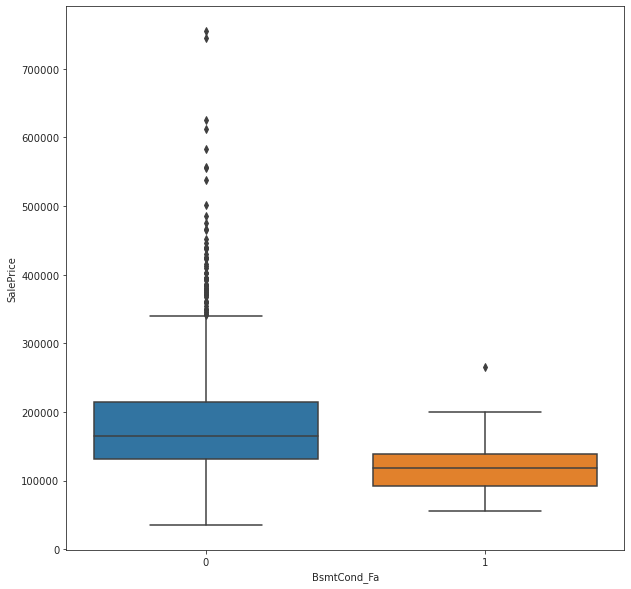

...

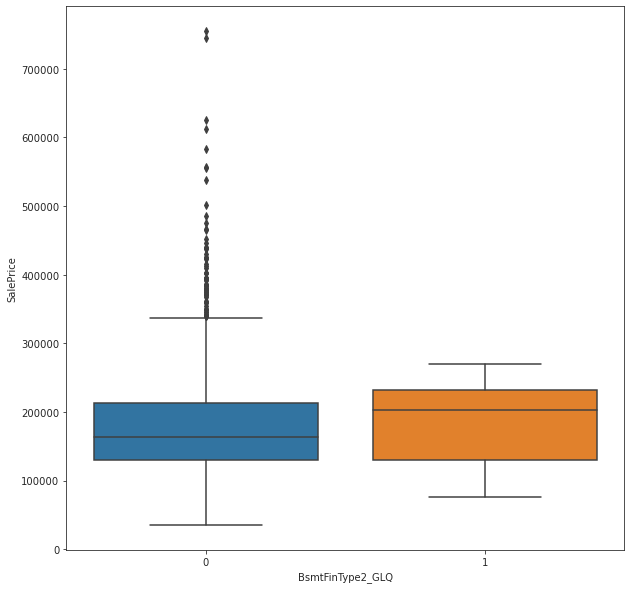

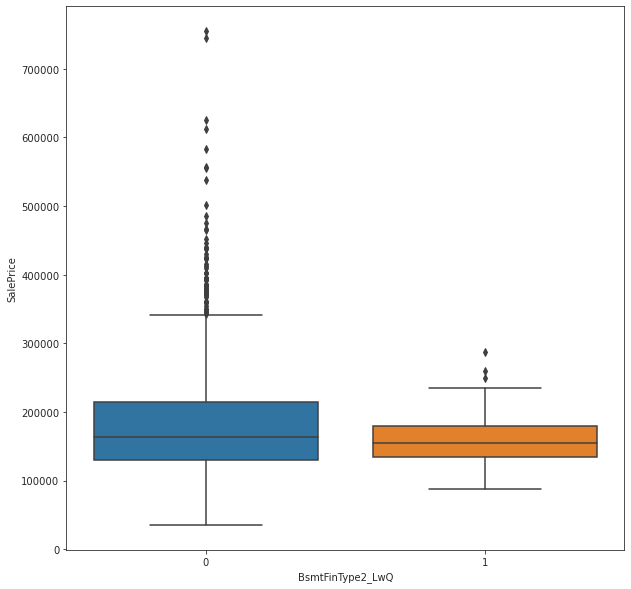

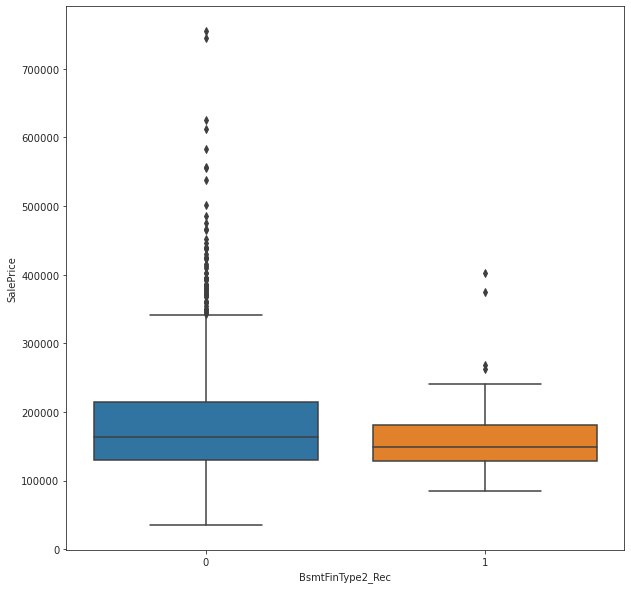

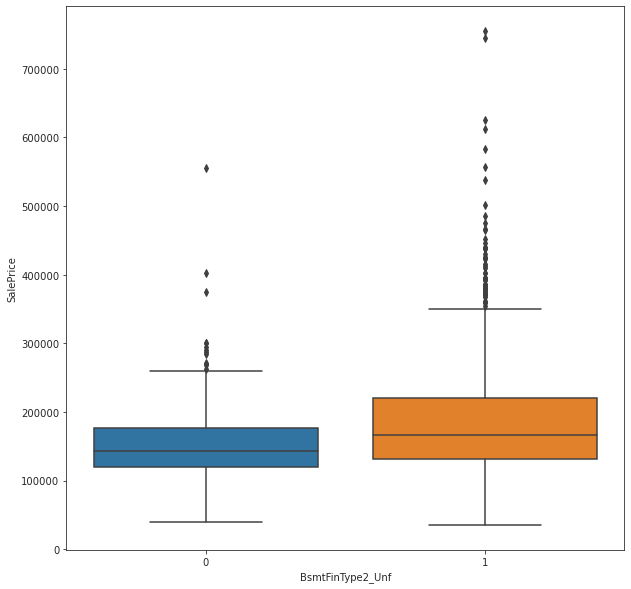

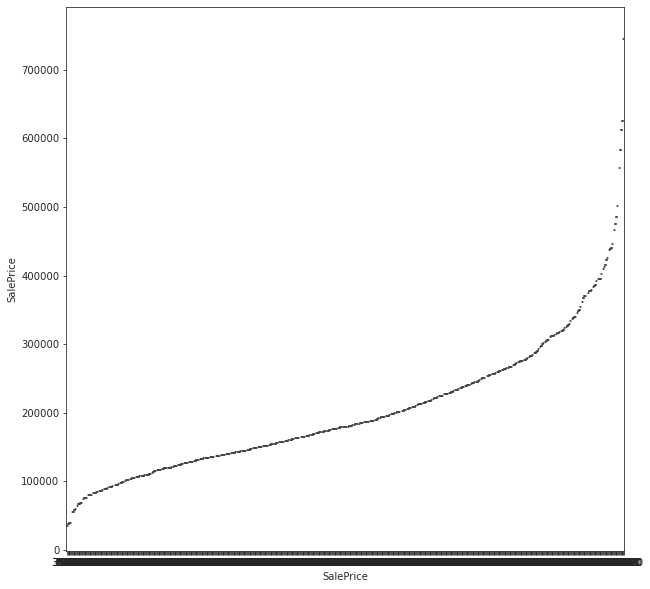

In [34]:
for i,column in enumerate(dummies_categorical.columns):
    f = plt.figure(figsize=(10,10))
    plot_boxplot(dummies_categorical, column, target_feature)
    #sns.scatterplot(data=dummies_categorical, x=column, y=target_feature)


As with the numerical variables, we need to filter the correlation matrix and take only with the variables with coefficient bigger than 0.4

In [35]:
good_dummies=dummies_categorical.corr()["SalePrice"][dummies_categorical.corr()["SalePrice"]>0.4]

In [36]:
list(good_dummies.index)

['BsmtFinType1_GLQ',
 'ExterQual_Ex',
 'ExterQual_Gd',
 'Neighborhood_NridgHt',
 'GarageFinish_Fin',
 'BsmtQual_Ex',
 'Foundation_PConc',
 'HeatingQC_Ex',
 'KitchenQual_Ex',
 'SalePrice']

In [37]:
categorical_clean=dummies_categorical[list(good_dummies.index)]

In [38]:
categorical_clean

,BsmtFinType1_GLQ,ExterQual_Ex,ExterQual_Gd,Neighborhood_NridgHt,GarageFinish_Fin,BsmtQual_Ex,Foundation_PConc,HeatingQC_Ex,KitchenQual_Ex,SalePrice
0,1,0,1,0,0,0,1,1,0,208500
1,0,0,0,0,0,0,0,1,0,181500
2,1,0,1,0,0,0,1,1,0,223500
3,0,0,0,0,0,0,0,0,0,140000
4,1,0,1,0,0,0,1,1,0,250000
...,...,...,...,...,...,...,...,...,...,...
1455,0,0,0,0,0,0,1,1,0,175000
1456,0,0,0,0,0,0,0,0,0,210000
1457,1,1,0,0,0,0,0,1,0,266500
1458,1,0,0,0,0,0,0,0,0,142125


In [39]:
categorical_clean

,BsmtFinType1_GLQ,ExterQual_Ex,ExterQual_Gd,Neighborhood_NridgHt,GarageFinish_Fin,BsmtQual_Ex,Foundation_PConc,HeatingQC_Ex,KitchenQual_Ex,SalePrice
0,1,0,1,0,0,0,1,1,0,208500
1,0,0,0,0,0,0,0,1,0,181500
2,1,0,1,0,0,0,1,1,0,223500
3,0,0,0,0,0,0,0,0,0,140000
4,1,0,1,0,0,0,1,1,0,250000
...,...,...,...,...,...,...,...,...,...,...
1455,0,0,0,0,0,0,1,1,0,175000
1456,0,0,0,0,0,0,0,0,0,210000
1457,1,1,0,0,0,0,0,1,0,266500
1458,1,0,0,0,0,0,0,0,0,142125


# Combining the tables

In [40]:
dataf=pd.concat([numerical_clean, categorical_clean], axis=1)

In [41]:
dataf

,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,GarageArea,BsmtFinType1_GLQ,ExterQual_Ex,ExterQual_Gd,Neighborhood_NridgHt,GarageFinish_Fin,BsmtQual_Ex,Foundation_PConc,HeatingQC_Ex,KitchenQual_Ex,SalePrice
0,7,2003,2003,856,856,1710,2,8,2,548,1,0,1,0,0,0,1,1,0,208500
1,6,1976,1976,1262,1262,1262,2,6,2,460,0,0,0,0,0,0,0,1,0,181500
2,7,2001,2002,920,920,1786,2,6,2,608,1,0,1,0,0,0,1,1,0,223500
3,7,1915,1970,756,961,1717,1,7,3,642,0,0,0,0,0,0,0,0,0,140000
4,8,2000,2000,1145,1145,2198,2,9,3,836,1,0,1,0,0,0,1,1,0,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,6,1999,2000,953,953,1647,2,7,2,460,0,0,0,0,0,0,1,1,0,175000
1456,6,1978,1988,1542,2073,2073,2,7,2,500,0,0,0,0,0,0,0,0,0,210000
1457,7,1941,2006,1152,1188,2340,2,9,1,252,1,1,0,0,0,0,0,1,0,266500
1458,5,1950,1996,1078,1078,1078,1,5,1,240,1,0,0,0,0,0,0,0,0,142125


In [42]:
null_counts_row(dataf,10)

,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,GarageArea,BsmtFinType1_GLQ,ExterQual_Ex,ExterQual_Gd,Neighborhood_NridgHt,GarageFinish_Fin,BsmtQual_Ex,Foundation_PConc,HeatingQC_Ex,KitchenQual_Ex,SalePrice


In [45]:
dataf = sm.add_constant(dataf)
dataf

,const,OverallQual,YearBuilt,YearRemodAdd,TotalBsmtSF,1stFlrSF,GrLivArea,FullBath,TotRmsAbvGrd,GarageCars,...,BsmtFinType1_GLQ,ExterQual_Ex,ExterQual_Gd,Neighborhood_NridgHt,GarageFinish_Fin,BsmtQual_Ex,Foundation_PConc,HeatingQC_Ex,KitchenQual_Ex,SalePrice
0,1.0,7,2003,2003,856,856,1710,2,8,2,...,1,0,1,0,0,0,1,1,0,208500
1,1.0,6,1976,1976,1262,1262,1262,2,6,2,...,0,0,0,0,0,0,0,1,0,181500
2,1.0,7,2001,2002,920,920,1786,2,6,2,...,1,0,1,0,0,0,1,1,0,223500
3,1.0,7,1915,1970,756,961,1717,1,7,3,...,0,0,0,0,0,0,0,0,0,140000
4,1.0,8,2000,2000,1145,1145,2198,2,9,3,...,1,0,1,0,0,0,1,1,0,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1.0,6,1999,2000,953,953,1647,2,7,2,...,0,0,0,0,0,0,1,1,0,175000
1456,1.0,6,1978,1988,1542,2073,2073,2,7,2,...,0,0,0,0,0,0,0,0,0,210000
1457,1.0,7,1941,2006,1152,1188,2340,2,9,1,...,1,1,0,0,0,0,0,1,0,266500
1458,1.0,5,1950,1996,1078,1078,1078,1,5,1,...,1,0,0,0,0,0,0,0,0,142125


In [54]:
dataf=pd.concat([dataf,numerical_houses['SalePrice']], axis=1)

In [52]:
dataf.drop(['SalePrice'],
              axis=1, inplace=True)

In [55]:
dataf.columns

Index(['const', 'OverallQual', 'YearBuilt', 'YearRemodAdd', 'TotalBsmtSF',
       '1stFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars',
       'GarageArea', 'BsmtFinType1_GLQ', 'ExterQual_Ex', 'ExterQual_Gd',
       'Neighborhood_NridgHt', 'GarageFinish_Fin', 'BsmtQual_Ex',
       'Foundation_PConc', 'HeatingQC_Ex', 'KitchenQual_Ex', 'SalePrice'],
      dtype='object')

# Predictive Model
Now we want to prepare our data to use multilinear regression. 

In [56]:
y = dataf[target_feature]
X = dataf[ list(dataf.columns)[:-1]]
lin_reg = sm.OLS(y, X).fit()

In [57]:
lin_reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.809
Method:                 Least Squares   F-statistic:                     325.7
Date:                Sun, 13 Sep 2020   Prob (F-statistic):               0.00
Time:                        22:16:14   Log-Likelihood:                -17327.
No. Observations:                1460   AIC:                         3.469e+04
Df Residuals:                    1440   BIC:                         3.480e+04
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                -7.165e+05   1.42e+05     -5.050      0.000   -9.95e+05   -4.38e+05
OverallQual           1.288e+04   1199.750     10.739      0.000    1.05e+04    1.52e+04
YearBuilt              184.2056     50.503      3.647      0.000      85.137     283.274
YearRemodAdd           164.0417     62.128      2.640      0.008      42.170     285.913
TotalBsmtSF             13.7552      3.971      3.464      0.001       5.965      21.545
1stFlrSF                 8.3287      4.599      1.811      0.070      -0.693      17.350
GrLivArea               52.9267      3.947     13.409      0.000      45.184      60.669
FullBath             -2504.5610   2498.603     -1.002      0.316   -7405.852    2396.730
TotRmsAbvGrd          -988.3744   1042.931     -0.948      0.343   -3034.200    1057.452
GarageCars            1.195e+04   2822.652      4.232      0.000    6409.130    1.75e+04
GarageArea               3.6718      9.572      0.384      0.701     -15.105      22.449
BsmtFinType1_GLQ      1.276e+04   2423.008      5.264      0.000    8002.291    1.75e+04
ExterQual_Ex          2.343e+04   7140.901      3.281      0.001    9421.663    3.74e+04
ExterQual_Gd          6708.3113   3051.991      2.198      0.028     721.487    1.27e+04
Neighborhood_NridgHt  1.449e+04   4919.955      2.946      0.003    4842.036    2.41e+04
GarageFinish_Fin      5203.2401   2477.151      2.100      0.036     344.028    1.01e+04
BsmtQual_Ex           2.921e+04   4482.069      6.517      0.000    2.04e+04     3.8e+04
Foundation_PConc     -4449.3434   2827.063     -1.574      0.116   -9994.947    1096.260
HeatingQC_Ex          4363.0397   2331.678      1.871      0.062    -210.810    8936.890
KitchenQual_Ex        2.628e+04   4787.569      5.490      0.000    1.69e+04    3.57e+04
==============================================================================
Omnibus:                      762.857   Durbin-Watson:                   1.994
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           100302.938
Skew:                          -1.412   Prob(JB):                         0.00
Kurtosis:                      43.507   Cond. No.                     5.63e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.63e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [58]:
dataf = dataf.assign(SalePrice_hat=lin_reg.predict(dataf[ list(dataf.columns)[:-1]]))

In [60]:
dataf[['SalePrice', 'SalePrice_hat']]

,SalePrice,SalePrice_hat
0,208500,212986.383785
1,181500,162594.358592
2,223500,220086.783165
3,140000,187639.259424
4,250000,269050.904704
...,...,...
1455,175000,178883.228184
1456,210000,213256.312712
1457,266500,249387.335420
1458,142125,133531.605411


# Summary 



- We obtained 80% accuracy in our multilinear model
- To improve our model we need to detect and remove colinearity among the features 
- In order to make more accurate our model is also possible reduce the Skewness 
- we can observe that the obteined P-values are very low. 
- Some of the coefficients are very big, it can be useful use standard features